# Importações

In [1]:
import pandas as pd
import numpy as np
import numpy.random as rnd
import datetime
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from os import listdir
from os.path import join
import os

from sklearn.metrics import silhouette_score
from joblib import Parallel, delayed

# Função para representar as imagens segmentadas

In [63]:
def process_and_save_segmented_images(segmented_list, output_folder, k):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for i, segmented in enumerate(segmented_list):
        # Determine o tamanho da imagem a partir do número total de pixels
        num_pixels = len(segmented.Class)

        # Pega o tamanho da imagem original para exibir a imagem segmentada
        img_path = f'ALL_IDB2/Im{i + 1:03d}_1.tif' if i < 130 else f'ALL_IDB2/Im{i + 1:03d}_0.tif'
        og_img = mpimg.imread(img_path)
        height = og_img.shape[0]
        width = og_img.shape[1]
        # Cria uma imagem vazia com base no tamanho determinado
        img = np.zeros((height, width, 3), dtype=np.uint8)
        # Preenche a imagem com base na classificação dos pixels
        if k == 2:
            for j in range(height):
                for k in range(width):
                    if segmented.Class[j * width + k] == 'C1':
                        img[j, k] = [0, 255, 0]  # Verde
                    else:
                        img[j, k] = [255, 255, 0]  # Amarelo
        else:
            for j in range(height):
                for k in range(width):
                    if segmented.Class[j * width + k] == 'C1':
                        img[j, k] = [0, 255, 0]  # Verde
                    elif segmented.Class[j * width + k] == 'C2':
                        img[j, k] = [255, 255, 0]  # Amarelo
                    else:
                        img[j, k] = [0, 0, 255]  # Vermelho
                        
        plt.figure(figsize=(2, 2))
        plt.imshow(img)
        plt.axis('off')
        plt.title(f'Segmented Image {i + 1}', fontsize=20)
        plt.show()
        
        # Salva a imagem
        image_path = os.path.join(output_folder, f'segmented_image_{i + 1}.png')
        plt.imsave(image_path, img)

# [RGB]

# Colocando as imagens para uso no código 

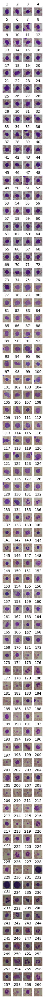

In [2]:
# Fig = Figura, ax é o vetor de objetos Axes
# Número de linhas = 65 x Número de colunas = 4 imagens
fig, ax = plt.subplots(nrows=65, ncols=4, figsize=(2,50))
img_list_rgb = [] # Cria lista para as imagens dos leucócitos

for x in range(1, 131):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_1.tif'
    img_list_rgb.append(mpimg.imread(img_path))
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_rgb[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)

for x in range(131, 261):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_0.tif'
    img_list_rgb.append(mpimg.imread(img_path))
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_rgb[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)

plt.savefig('imagens_carregadas_rgb.png')
plt.show()

# Data frame

In [3]:
dfs_rgb = [] # Vetor de data frames
for i in range(1, 261):
  df = pd.DataFrame({'R': img_list_rgb[i-1][:, :, 0].flatten(), 'G': img_list_rgb[i-1][:, :, 1].flatten(), 'B':img_list_rgb[i-1][:, :, 2].flatten()})
  dfs_rgb.append(df)

# Implementação do K-Means

In [4]:
# Distância
def distance_calc_rgb(data, centroids, k):
  cols=list()
  for i in range(1,k+1):
    # Euclidean
    data[f'C{i}'] = ((centroids[i-1][0]-data.R)**2+(centroids[i-1][1]-data.G)**2+(centroids[i-1][2]-data.B)**2)**0.5
    cols.append(f'C{i}')
  data['Class'] = data[cols].abs().idxmin(axis=1)
  return data


In [5]:
# KMeans
def kmeans_rgb(data, K):
  print(10*'-', f'k={K}\tEuclidean distance RGB', '-'*10)
  L = list()
  new_centroids = data.sample(K).values

  data = distance_calc_rgb(data.copy(), new_centroids, K)
  old_centroids = new_centroids.copy()
  new_centroids = np.array([data[data.Class == Class][['R', 'G', 'B']].mean().values for Class in data.loc[:,'C1':f'C{K}'].columns])
  i = 1
  print(f'Iteration: {i}\tDistance: {abs(new_centroids.mean()-old_centroids.mean())}')
  while abs(new_centroids.mean()-old_centroids.mean())>0.001: # 0.001
    L.append(abs(new_centroids.mean()-old_centroids.mean()))
    data = distance_calc_rgb(data, new_centroids, K)
    old_centroids = new_centroids.copy()
    new_centroids = np.array([data[data.Class == Class][['R', 'G', 'B']].mean().values for Class in data.loc[:,'C1':f'C{K}'].columns])
    #if np.isnan(new_centroids).any(): #in case there is an empty cluster
    i+=1
    print(f'Iteration: {i}\tDistance: {abs(new_centroids.mean()-old_centroids.mean())}')
  print(f"k-Means has ended with {i} iteratinons")
  return data, L


# K = 2

In [73]:
def process_kmeans_rgb_2(dfs_rgb, k2_rgb=2):
    segmented_list_k2_rgb = []
    distances_k2_rgb = []
    for i in range(1, 261):
        if i < 131:
            print("Im" + str(i).zfill(3) + "_1.tif")
        else:
            print("Im" + str(i).zfill(3) + "_0.tif")
        
        segmented, distance = kmeans_rgb(dfs_rgb[i-1], k2_rgb)
        segmented_list_k2_rgb.append(segmented)
        distances_k2_rgb.append(distance)
    
    return segmented_list_k2_rgb, distances_k2_rgb

segmented_list_k2_rgb, distances_k2_rgb = process_kmeans_rgb_2(dfs_rgb)

Im001_1.tif
---------- k=2	Euclidean distance RGB ----------
Iteration: 1	Distance: 41.389780759584184
Iteration: 2	Distance: 10.735877069412041
Iteration: 3	Distance: 8.704494727718213
Iteration: 4	Distance: 2.8155218014289574
Iteration: 5	Distance: 0.45663004514887007
Iteration: 6	Distance: 0.08523341716816901
Iteration: 7	Distance: 0.02728169934418645
Iteration: 8	Distance: 0.0019298989554101809
Iteration: 9	Distance: 0.0
k-Means has ended with 9 iteratinons
Im002_1.tif
---------- k=2	Euclidean distance RGB ----------
Iteration: 1	Distance: 26.941465990050318
Iteration: 2	Distance: 3.2512213833182386
Iteration: 3	Distance: 4.426683629435232
Iteration: 4	Distance: 5.968104290250309
Iteration: 5	Distance: 6.523259832220518
Iteration: 6	Distance: 2.4200379967273307
Iteration: 7	Distance: 0.24038237487630454
Iteration: 8	Distance: 0.017883162979842382
Iteration: 9	Distance: 0.004772469828736803
Iteration: 10	Distance: 0.0
k-Means has ended with 10 iteratinons
Im003_1.tif
---------- k=2	

# K = 2 RGB Segmented Images

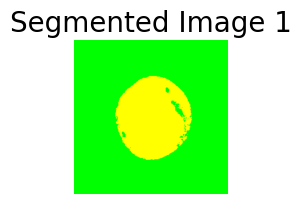

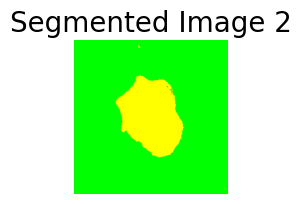

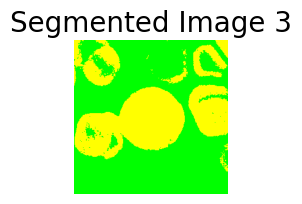

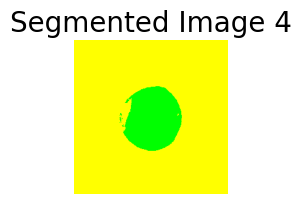

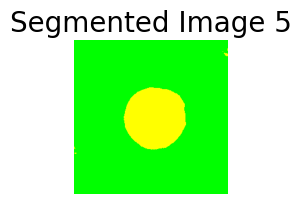

...

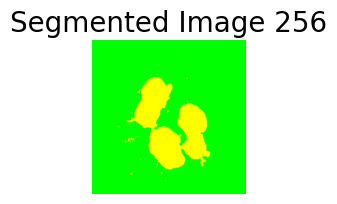

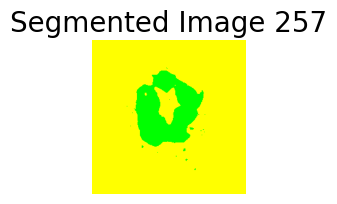

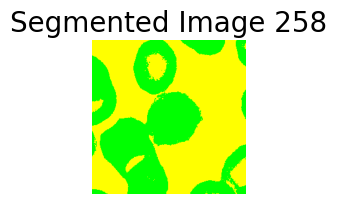

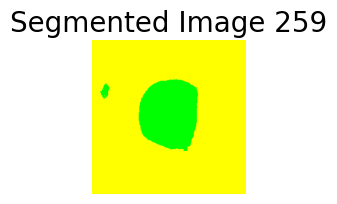

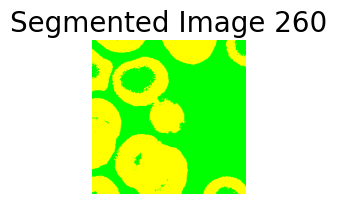

In [75]:
# Caminho para a pasta onde as imagens serão salvas
output_folder = 'segmented_images_rgb_k2'

# Processa e salva as imagens segmentadas
process_and_save_segmented_images(segmented_list_k2_rgb, output_folder, 2)

# K = 2 RGB Silhouette Score

In [18]:
def calculate_silhouette(i, df):
    segmented_df = df[i-1]
    score = silhouette_score(segmented_df.loc[:, :'C2'], segmented_df.Class, metric='euclidean')
    print(f'Img {i}: {score}')
    return score

scores_k2_rgb = Parallel(n_jobs=4)(delayed(calculate_silhouette)(i, segmented_list_k2_rgb) for i in range(1, 261))
score_k2_rgb_media = sum(scores_k2_rgb)/len(scores_k2_rgb)
print(f'Média: {score_k2_rgb_media}')

Img 1: 0.7859598165226619
Img 3: 0.6027664308101969
Img 2: 0.7706473452676242
Img 4: 0.8058269449017909
Img 5: 0.8183126920505249
Img 7: 0.7185747045192511
Img 6: 0.8306372095894108
Img 8: 0.7383595915231919
Img 9: 0.7355196582812583
Img 10: 0.69803157334134
Img 11: 0.7226400469353015
Img 12: 0.7674109537497237
Img 13: 0.5727662279368011
Img 14: 0.787520770033501
Img 15: 0.8271230111687569
Img 16: 0.8000181791208464
Img 17: 0.7808782459110971
Img 18: 0.7467511957720103
Img 19: 0.5075561518882602
Img 20: 0.7513104957034619
Img 21: 0.7229441578546166
Img 22: 0.7551791931486357
Img 23: 0.781709564523459
Img 24: 0.7983661235388018
Img 25: 0.7594102441569572
Img 26: 0.7853445682290443
Img 27: 0.7394117067729021
Img 28: 0.7617907644186891
Img 29: 0.7798727726924323
Img 30: 0.7736880006928285
Img 31: 0.7696187554194167
Img 32: 0.7274781471485547
Img 33: 0.7870498170044515
Img 34: 0.7388808790361043
Img 35: 0.7462638715641545
Img 36: 0.6906158582393624
Img 37: 0.5556450922563082
Img 38: 0.7522

# K = 3


In [6]:
def process_kmeans_rgb_3(dfs_rgb, k3_rgb=3):
    segmented_list_k3_rgb = []
    distances_k3_rgb = []
    for i in range(1, 261):
        if i < 131:
            print("Im" + str(i).zfill(3) + "_1.tif")
        else:
            print("Im" + str(i).zfill(3) + "_0.tif")
        
        segmented, distance = kmeans_rgb(dfs_rgb[i-1], k3_rgb)
        segmented_list_k3_rgb.append(segmented)
        distances_k3_rgb.append(distance)
    
    return segmented_list_k3_rgb, distances_k3_rgb

segmented_list_k3_rgb, distances_k3_rgb = process_kmeans_rgb_3(dfs_rgb)

Im001_1.tif
---------- k=3	Euclidean distance RGB ----------
Iteration: 1	Distance: 3.103395193719024
Iteration: 2	Distance: 8.52483931483684
Iteration: 3	Distance: 2.213730652786751
Iteration: 4	Distance: 0.6246584154584696
Iteration: 5	Distance: 0.2168097989631974
Iteration: 6	Distance: 0.09336541192958236
Iteration: 7	Distance: 0.03761951645743977
Iteration: 8	Distance: 0.007518075135294566
Iteration: 9	Distance: 0.004019513415997267
Iteration: 10	Distance: 0.0004564202113499505
k-Means has ended with 10 iteratinons
Im002_1.tif
---------- k=3	Euclidean distance RGB ----------
Iteration: 1	Distance: 16.473199284146858
Iteration: 2	Distance: 9.049237887460748
Iteration: 3	Distance: 3.855677068464729
Iteration: 4	Distance: 0.25136714014975325
Iteration: 5	Distance: 0.008683944487003714
Iteration: 6	Distance: 0.00801102254831676
Iteration: 7	Distance: 0.00039171225282075284
k-Means has ended with 7 iteratinons
Im003_1.tif
---------- k=3	Euclidean distance RGB ----------
Iteration: 1	Dis

# K = 3 RGB Segmented Images

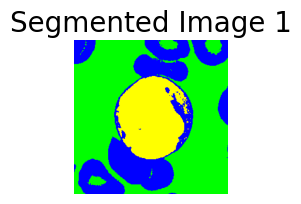

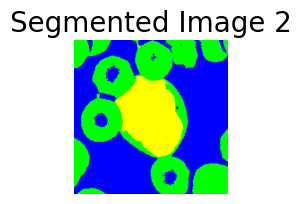

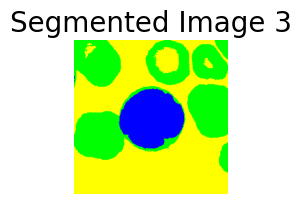

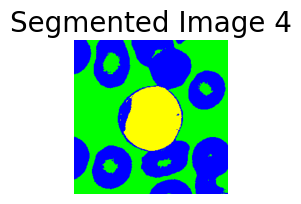

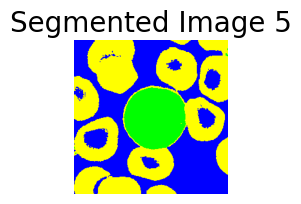

...

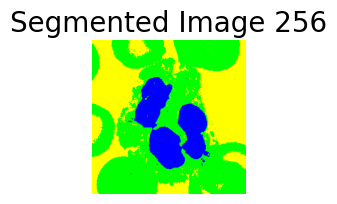

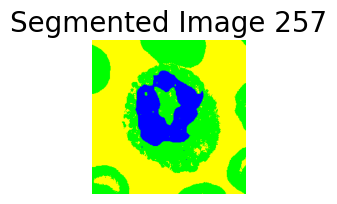

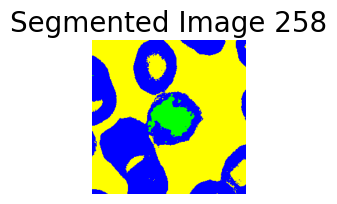

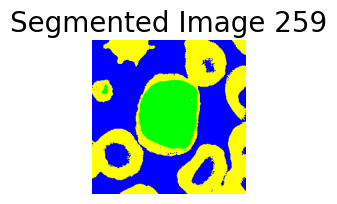

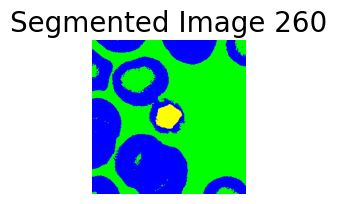

In [78]:
# Caminho para a pasta onde as imagens serão salvas
output_folder = 'segmented_images_rgb_k3'

# Processa e salva as imagens segmentadas
process_and_save_segmented_images(segmented_list_k3_rgb, output_folder, 3)

# K = 3 RGB Silhouette Score

In [7]:
def calculate_silhouette(i, df):
    segmented_df = df[i-1]
    score = silhouette_score(segmented_df.loc[:, :'C3'], segmented_df.Class, metric='euclidean')
    print(f'Img {i}: {score}')
    return score

scores_k3_rgb = Parallel(n_jobs=4)(delayed(calculate_silhouette)(i, segmented_list_k3_rgb) for i in range(1, 261))
score_k3_rgb_media = sum(scores_k3_rgb)/len(scores_k3_rgb)
print(f'Média: {score_k3_rgb_media}')

Img 1: 0.7731546033805474
Img 2: 0.7540556122085907
Img 3: 0.7862715169300954
Img 4: 0.7614722477764461
Img 5: 0.72247898291779
Img 6: 0.7971092206659307
Img 7: 0.7154319394850183
Img 8: 0.7391943664350927
Img 9: 0.716351754923924


/home/herbele/disciplinas/2024-1/pib/myenv/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Img 10: 0.6809614429107207
Img 11: 0.7414060465262651
Img 12: 0.7592156291377445
Img 13: 0.7677570194184159
Img 14: 0.7487823356577371
Img 16: 0.777872364063448
Img 15: 0.7638280606402015
Img 17: 0.7411797492479639
Img 18: 0.727178784795931
Img 19: 0.7342529272280973
Img 20: 0.7391299879640169
Img 21: 0.7192090007016821
Img 22: 0.7588640441579594
Img 23: 0.7917063622987303
Img 24: 0.7255767358797383
Img 25: 0.7432863570308528
Img 26: 0.7585563813164256
Img 27: 0.7354943879445136
Img 28: 0.7576208727921377
Img 29: 0.7546719748301444
Img 30: 0.7419712696828937
Img 31: 0.7664250930681347
Img 32: 0.7532833644648812
Img 33: 0.73735416318353
Img 34: 0.7011192468879307
Img 35: 0.7186929822083802
Img 36: 0.7115961721266387
Img 37: 0.7414078898730387
Img 38: 0.7560487041514747
Img 39: 0.7525815312764976
Img 40: 0.7114618834526979
Img 41: 0.6913991005921943
Img 42: 0.7583534130210866
Img 43: 0.7698333297108357
Img 44: 0.7278055129119904
Img 45: 0.7733007565242176
Img 46: 0.7103522738784226
Img 4

# [HSV]

# Importação da função de transformação RGB -> HSV

In [8]:
from matplotlib.colors import rgb_to_hsv

# Colocando as imagens para uso no código

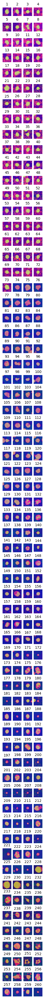

In [9]:
# Criar a pasta se não existir
output_folder = 'hsv_images'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Fig = Figura, ax é o vetor de objetos Axes
# Número de linhas = 65 x Número de colunas = 4 imagens
fig, ax = plt.subplots(nrows=65, ncols=4, figsize=(2,50))
img_list_hsv = [] # Cria lista para as imagens dos leucócitos

# A função mpimg.imread retorna um array com os canais de cores em intervalo 0..255
# Já a função rgb_to_hsv precisa que o intervalo rgb representado esteja entre 0..1

for x in range(1, 131):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_1.tif'
    img_rgb =mpimg.imread(img_path)
    img_rgb = np.asarray(img_rgb, dtype=np.float32) / 255.0  # Normalizar a imagem para [0, 1]
    img_hsv = rgb_to_hsv(img_rgb)
    img_list_hsv.append(img_hsv)
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_hsv[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)
    # Salvar imagem HSV
    save_path = os.path.join(output_folder, f'img_{x:03d}.png')
    plt.imsave(save_path, img_hsv)

for x in range(131, 261):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_0.tif'
    img_rgb =mpimg.imread(img_path)
    img_rgb = np.asarray(img_rgb, dtype=np.float32) / 255.0  # Normalizar a imagem para [0, 1]
    img_hsv = rgb_to_hsv(img_rgb)
    img_list_hsv.append(img_hsv)
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_hsv[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)
    # Salvar imagem HSV
    save_path = os.path.join(output_folder, f'img_{x:03d}.png')
    plt.imsave(save_path, img_hsv)

plt.savefig('imagens_carregadas_hsv.png')
plt.show()

# Data Frame


In [10]:
dfs_hsv = [] # Vetor de data frames
for i in range(1, 261):
  df = pd.DataFrame({'H': img_list_hsv[i-1][:, :, 0].flatten(), 'S': img_list_hsv[i-1][:, :, 1].flatten(), 'V':img_list_hsv[i-1][:, :, 2].flatten()})
  dfs_hsv.append(df)

# Implementação do K-Means

In [11]:
# Distância
def distance_calc_hsv(data, centroids, k):
  cols=list()
  for i in range(1,k+1):
    # Euclidean
    data[f'C{i}'] = ((centroids[i-1][0]-data.H)**2+(centroids[i-1][1]-data.S)**2+(centroids[i-1][2]-data.V)**2)**0.5
    cols.append(f'C{i}')
  data['Class'] = data[cols].abs().idxmin(axis=1)
  return data

In [12]:
# KMeans
def kmeans_hsv(data, K):
  print(10*'-', f'k={K}\tEuclidean distance HSV', '-'*10)
  L = list()
  new_centroids = data.sample(K).values

  data = distance_calc_hsv(data.copy(), new_centroids, K)
  old_centroids = new_centroids.copy()
  new_centroids = np.array([data[data.Class == Class][['H', 'S', 'V']].mean().values for Class in data.loc[:,'C1':f'C{K}'].columns])
  i = 1
  print(f'Iteration: {i}\tDistance: {abs(new_centroids.mean()-old_centroids.mean())}')
  while abs(new_centroids.mean()-old_centroids.mean())>0.001: # 0.001
    L.append(abs(new_centroids.mean()-old_centroids.mean()))
    data = distance_calc_hsv(data, new_centroids, K)
    old_centroids = new_centroids.copy()
    new_centroids = np.array([data[data.Class == Class][['H', 'S', 'V']].mean().values for Class in data.loc[:,'C1':f'C{K}'].columns])
    #if np.isnan(new_centroids).any(): #in case there is an empty cluster
    i+=1
    print(f'Iteration: {i}\tDistance: {abs(new_centroids.mean()-old_centroids.mean())}')
  print(f"k-Means has ended with {i} iteratinons")
  return data, L

# K = 2

In [21]:
def process_kmeans_hsv_2(dfs_hsv, k2_hsv=2):
    segmented_list_k2_hsv = []
    distances_k2_hsv = []
    for i in range(1, 261):
        if i < 131:
            print("Im" + str(i).zfill(3) + "_1.tif")
        else:
            print("Im" + str(i).zfill(3) + "_0.tif")
        
        segmented, distance = kmeans_hsv(dfs_hsv[i-1], k2_hsv)
        segmented_list_k2_hsv.append(segmented)
        distances_k2_hsv.append(distance)
    
    return segmented_list_k2_hsv, distances_k2_hsv

segmented_list_k2_hsv, distances_k2_hsv = process_kmeans_hsv_2(dfs_hsv)


Im001_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.0020640790462493896
Iteration: 2	Distance: 0.0018160045146942139
Iteration: 3	Distance: 9.906291961669922e-05
k-Means has ended with 3 iteratinons
Im002_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.039175063371658325
Iteration: 2	Distance: 0.001591503620147705
Iteration: 3	Distance: 9.208917617797852e-06
k-Means has ended with 3 iteratinons
Im003_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.006100684404373169
Iteration: 2	Distance: 0.0011436641216278076
Iteration: 3	Distance: 0.00010198354721069336
k-Means has ended with 3 iteratinons
Im004_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.047400861978530884
Iteration: 2	Distance: 0.011603444814682007
Iteration: 3	Distance: 0.005143463611602783
Iteration: 4	Distance: 0.0002988576889038086
k-Means has ended with 4 iteratinons
Im005_1.tif
---------- k=2	E

# K = 2 HSV Segmented Images

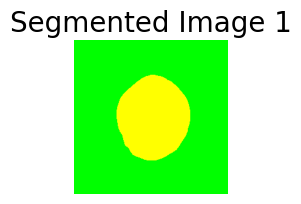

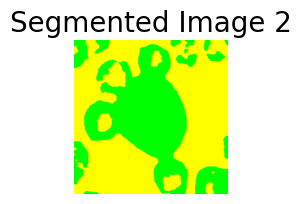

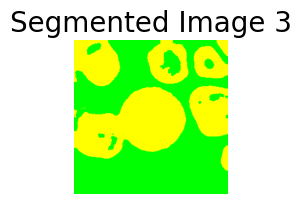

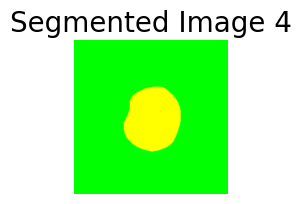

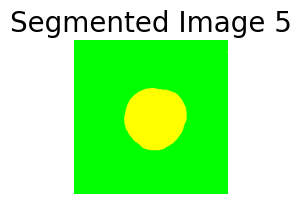

...

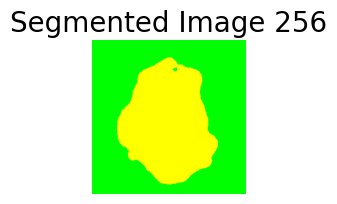

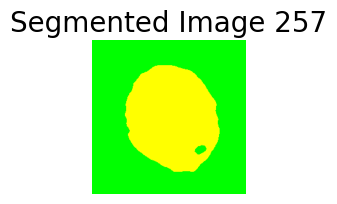

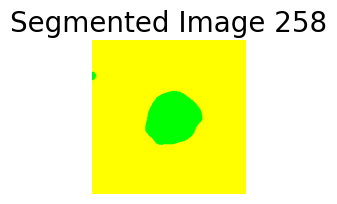

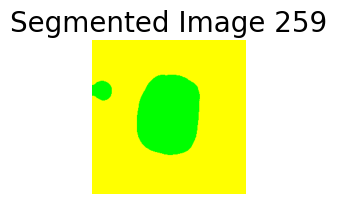

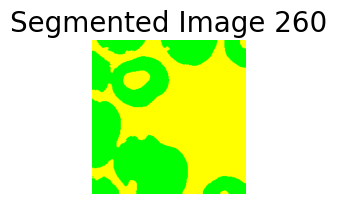

In [96]:
# Caminho para a pasta onde as imagens serão salvas
output_folder = 'segmented_images_hsv_k2'

# Processa e salva as imagens segmentadas
process_and_save_segmented_images(segmented_list_k2_hsv, output_folder, 2)

# K = 2 HSV Silhouette Score

In [27]:
def calculate_silhouette(i, df):
    segmented_df = df[i-1]
    score = silhouette_score(segmented_df.loc[:, :'C2'], segmented_df.Class, metric='euclidean')
    print(f'Img {i}: {score}')
    return score

scores_k2_hsv = Parallel(n_jobs=4)(delayed(calculate_silhouette)(i, segmented_list_k2_hsv) for i in range(1, 261))
score_k2_hsv_media = sum(scores_k2_hsv)/len(scores_k2_hsv) 
print(f'Média: {score_k2_hsv_media}')

Img 1: 0.6939008831977844


/home/herbele/disciplinas/2024-1/pib/myenv/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Img 2: 0.638494074344635
Img 3: 0.5656862258911133
Img 4: 0.6570836901664734
Img 5: 0.7426022291183472
Img 6: 0.627556324005127
Img 7: 0.4182514548301697
Img 8: 0.4692898094654083
Img 9: 0.6219139099121094
Img 10: 0.7067385315895081
Img 11: 0.5838639736175537
Img 12: 0.6149801015853882
Img 13: 0.6460779905319214
Img 14: 0.49520406126976013
Img 15: 0.6395106911659241
Img 16: 0.4863867461681366
Img 17: 0.6276225447654724
Img 18: 0.5526202321052551
Img 19: 0.6874948143959045
Img 20: 0.6109106540679932
Img 21: 0.5684734582901001
Img 22: 0.6392861008644104
Img 23: 0.576143205165863
Img 24: 0.742320716381073
Img 25: 0.7385947704315186
Img 26: 0.5735400319099426
Img 27: 0.6391255259513855
Img 28: 0.6280100345611572
Img 29: 0.6013598442077637
Img 31: 0.5813091397285461
Img 30: 0.4728510081768036
Img 32: 0.6101531982421875
Img 33: 0.6123915314674377
Img 34: 0.6508708596229553
Img 35: 0.7078142166137695
Img 36: 0.6635693311691284
Img 37: 0.6721951365470886
Img 38: 0.6015097498893738
Img 39: 0.61

# K = 3

In [13]:
def process_kmeans_hsv_3(dfs_hsv, k3_hsv=3):
    segmented_list_k3_hsv = []
    distances_k3_hsv = []
    for i in range(1, 261):
        if i < 131:
            print("Im" + str(i).zfill(3) + "_1.tif")
        else:
            print("Im" + str(i).zfill(3) + "_0.tif")
        
        segmented, distance = kmeans_hsv(dfs_hsv[i-1], k3_hsv)
        segmented_list_k3_hsv.append(segmented)
        distances_k3_hsv.append(distance)
    
    return segmented_list_k3_hsv, distances_k3_hsv

segmented_list_k3_hsv, distances_k3_hsv = process_kmeans_hsv_3(dfs_hsv)

Im001_1.tif
---------- k=3	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.012009143829345703
Iteration: 2	Distance: 0.016966789960861206
Iteration: 3	Distance: 0.002304583787918091
Iteration: 4	Distance: 8.64863395690918e-05
k-Means has ended with 4 iteratinons
Im002_1.tif
---------- k=3	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.015026688575744629
Iteration: 2	Distance: 0.018524914979934692
Iteration: 3	Distance: 0.009018003940582275
Iteration: 4	Distance: 0.0012115240097045898
Iteration: 5	Distance: 0.00016129016876220703
k-Means has ended with 5 iteratinons
Im003_1.tif
---------- k=3	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.005568027496337891
Iteration: 2	Distance: 0.017810821533203125
Iteration: 3	Distance: 0.010405421257019043
Iteration: 4	Distance: 0.007719248533248901
Iteration: 5	Distance: 0.0012632310390472412
Iteration: 6	Distance: 1.0818243026733398e-05
k-Means has ended with 6 iteratinons
Im004_1.tif
---------- k=3	Euclidean dis

# K = 3 HSV Segmented Images

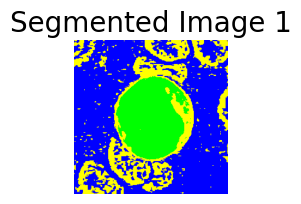

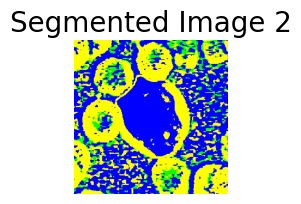

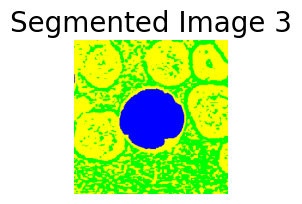

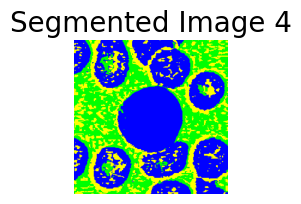

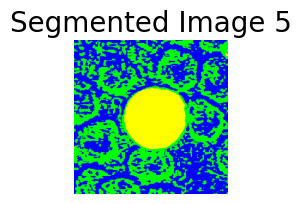

...

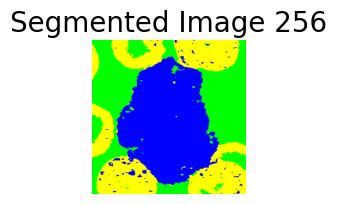

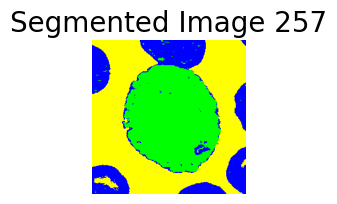

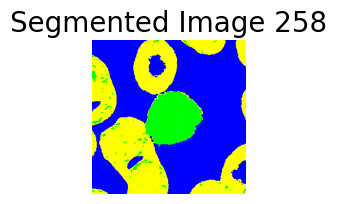

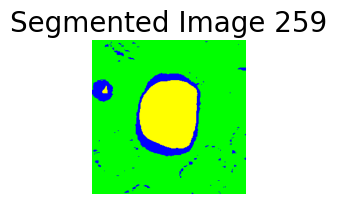

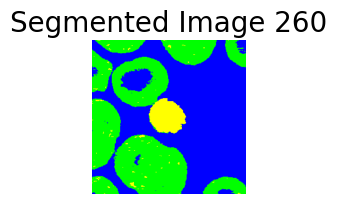

In [95]:
# Caminho para a pasta onde as imagens serão salvas
output_folder = 'segmented_images_hsv_k3'

# Processa e salva as imagens segmentadas
process_and_save_segmented_images(segmented_list_k3_hsv, output_folder, 3)

# K = 3 Silhouette Score

In [14]:
def calculate_silhouette(i, df):
    segmented_df = df[i-1]
    score = silhouette_score(segmented_df.loc[:, :'C3'], segmented_df.Class, metric='euclidean')
    print(f'Img {i}: {score}')
    return score

scores_k3_hsv = Parallel(n_jobs=4)(delayed(calculate_silhouette)(i, segmented_list_k3_hsv) for i in range(1, 261))
score_k3_hsv_media = sum(scores_k3_hsv)/len(scores_k3_hsv) 
print(f'Média: {score_k3_hsv_media}')

Img 1: 0.7434664964675903


/home/herbele/disciplinas/2024-1/pib/myenv/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Img 2: 0.7406085729598999
Img 3: 0.69894939661026
Img 4: 0.47689247131347656
Img 5: 0.8292249441146851
Img 6: 0.7191468477249146
Img 7: 0.6873906254768372
Img 8: 0.691318690776825
Img 9: 0.7354803681373596
Img 10: 0.7698445916175842
Img 11: 0.7284209728240967
Img 12: 0.7172827124595642
Img 13: 0.7402977347373962
Img 14: 0.648467481136322
Img 15: 0.727475643157959
Img 16: 0.6651595234870911
Img 17: 0.7354763150215149
Img 18: 0.6963258385658264
Img 19: 0.7320067286491394
Img 20: 0.7152952551841736
Img 21: 0.6901291608810425
Img 22: 0.7317942976951599
Img 23: 0.6925464868545532
Img 24: 0.8021277785301208
Img 25: 0.5822330117225647
Img 26: 0.7115596532821655
Img 27: 0.7419419884681702
Img 28: 0.7210911512374878
Img 29: 0.7186422348022461
Img 30: 0.622319221496582
Img 31: 0.6906412839889526
Img 32: 0.7155341506004333
Img 33: 0.6950375437736511
Img 34: 0.7477556467056274
Img 35: 0.7947741746902466
Img 36: 0.7423718571662903
Img 37: 0.7538673877716064
Img 38: 0.7184697389602661
Img 39: 0.7106

# Comparação da melhor média do silhouette score

In [38]:
valores = [
    (score_k2_rgb_media, 'RGB', 2),
    (score_k3_rgb_media, 'RGB', 3),
    (score_k2_hsv_media, 'HSV', 2),
    (score_k3_hsv_media, 'HSV', 3)
]
h_score = max(valores, key=lambda x: x[0])
print(f"Maior Score: {h_score[0]}, sistema de cores: {h_score[1]}, k = {h_score[2]}")


Maior Score: 0.7981057167053223, sistema de cores: HSV, k = 2


# CV2 import

In [16]:
import cv2 

# 11x11

In [17]:
kblur = (11, 11)
img_list_blur_11 = []
if h_score[1] == 'RGB':
    for i in range(1,261):
        img = cv2.blur(img_list_rgb[i-1], kblur)
        img_list_blur_11.append(img)
else:
    for i in range(1,261):
        img = cv2.blur(img_list_hsv[i-1], kblur)
        img_list_blur_11.append(img)

# Imagens com blur 11x11

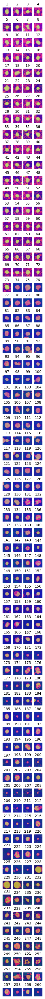

In [18]:
# Criar a pasta se não existir
output_folder = 'blur_images_11'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Fig = Figura, ax é o vetor de objetos Axes
# Número de linhas = 65 x Número de colunas = 4 imagens
fig, ax = plt.subplots(nrows=65, ncols=4, figsize=(2,50))

for x in range(1, 131):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_1.tif'
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_blur_11[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)
    # Salvar imagem HSV
    save_path = os.path.join(output_folder, f'img_{x:03d}.png')
    plt.imsave(save_path, img_list_blur_11[x-1])

for x in range(131, 261):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_0.tif'
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_blur_11[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)
    # Salvar imagem HSV
    save_path = os.path.join(output_folder, f'img_{x:03d}.png')
    plt.imsave(save_path, img_list_blur_11[x-1])

plt.savefig('imagens_carregadas_blur_11.png')
plt.show()

# Executa o K-Means após blur 11x11

In [19]:
dfs_h_11 = [] # Vetor de data frames

for i in range(1, 261):
  if h_score[1] == 'RGB':
    df = pd.DataFrame({'R': img_list_blur_11[i-1][:, :, 0].flatten(), 'G': img_list_blur_11[i-1][:, :, 1].flatten(), 'B':img_list_blur_11[i-1][:, :, 2].flatten()})
  else:
    df = pd.DataFrame({'H': img_list_blur_11[i-1][:, :, 0].flatten(), 'S': img_list_blur_11[i-1][:, :, 1].flatten(), 'V':img_list_blur_11[i-1][:, :, 2].flatten()})
  dfs_h_11.append(df)

In [22]:
h_segmented_list_11 = []
if h_score[1] == 'RGB':
    if h_score[2] == 2:
        segmented_list_k2_rgb, distances_k2_rgb = process_kmeans_rgb_2(dfs_h_11)
        h_segmented_list_11 = segmented_list_k2_rgb
    else:
        segmented_list_k3_rgb, distances_k3_rgb = process_kmeans_rgb_3(dfs_h_11)
        h_segmented_list_11 = segmented_list_k3_rgb
else:
    if h_score[2] == 2:
        segmented_list_k2_hsv, distances_k2_hsv = process_kmeans_hsv_2(dfs_h_11)
        h_segmented_list_11 = segmented_list_k2_hsv
    else:
        segmented_list_k3_hsv, distances_k3_hsv = process_kmeans_hsv_3(dfs_h_11)
        h_segmented_list_11 = segmented_list_k3_hsv

Im001_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.056454747915267944
Iteration: 2	Distance: 0.019609689712524414
Iteration: 3	Distance: 0.016783803701400757
Iteration: 4	Distance: 0.017076969146728516
Iteration: 5	Distance: 0.00795409083366394
Iteration: 6	Distance: 0.001380622386932373
Iteration: 7	Distance: 0.00022727251052856445
k-Means has ended with 7 iteratinons
Im002_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.0048427581787109375
Iteration: 2	Distance: 0.005612075328826904
Iteration: 3	Distance: 0.0009080767631530762
k-Means has ended with 3 iteratinons
Im003_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.03414931893348694
Iteration: 2	Distance: 0.008396565914154053
Iteration: 3	Distance: 0.0047953128814697266
Iteration: 4	Distance: 0.00217360258102417
Iteration: 5	Distance: 0.0009471476078033447
k-Means has ended with 5 iteratinons
Im004_1.tif
---------- k=2	Euclidean distan

# Imagens segmentadas pós blur 11x11

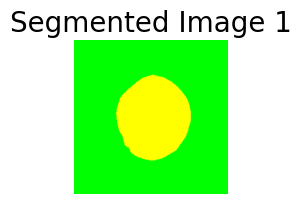

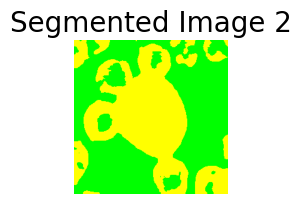

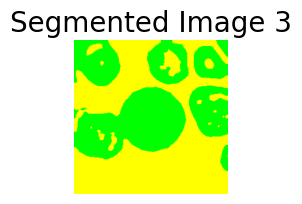

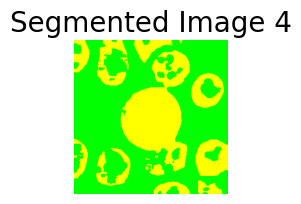

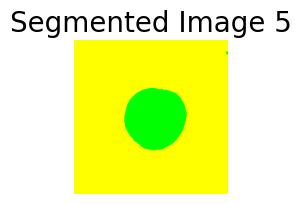

...

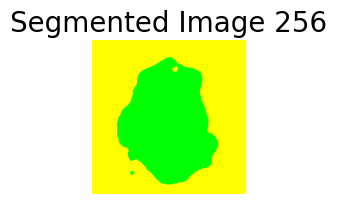

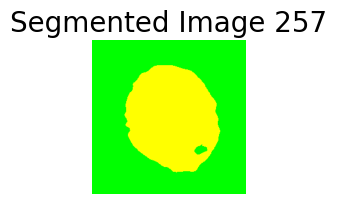

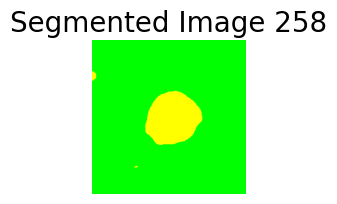

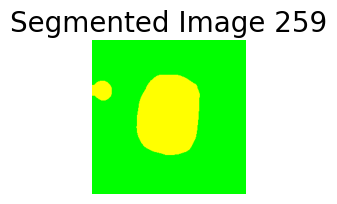

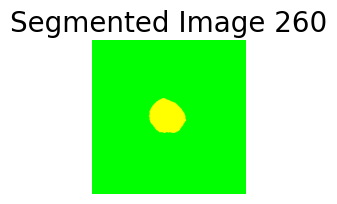

In [87]:
# Caminho para a pasta onde as imagens serão salvas
output_folder = 'segmented_images_high_score_11'

# Processa e salva as imagens segmentadas
process_and_save_segmented_images(h_segmented_list_11, output_folder, h_score[2])

# Score

In [23]:
def calculate_silhouette(i, df, k):
    segmented_df = df[i-1]
    if k == 2:
        score = silhouette_score(segmented_df.loc[:, :'C2'], segmented_df.Class, metric='euclidean')
    else:
        score = silhouette_score(segmented_df.loc[:, :'C3'], segmented_df.Class, metric='euclidean')
    print(f'Img {i}: {score}')
    return score

scores_blur11 = Parallel(n_jobs=4)(delayed(calculate_silhouette)(i, h_segmented_list_11, h_score[2]) for i in range(1, 261))
score_blur11_media = sum(scores_blur11)/len(scores_blur11) 
print(f'Média: {score_blur11_media}, Sistema de cores:{h_score[1]}, k = {h_score[2]}')

Img 1: 0.7553402781486511
Img 2: 0.7022339105606079
Img 3: 0.5850047469139099
Img 4: 0.7627745270729065
Img 5: 0.7506203651428223
Img 7: 0.7011992931365967
Img 6: 0.7888391613960266
Img 8: 0.7343066334724426
Img 9: 0.7295020818710327
Img 10: 0.4556514620780945
Img 12: 0.5947300791740417
Img 11: 0.6983245015144348
Img 13: 0.5479622483253479
Img 14: 0.7694283127784729
Img 15: 0.6059660911560059
Img 16: 0.7532311677932739
Img 17: 0.5478678941726685
Img 19: 0.4967537224292755
Img 18: 0.7220419645309448
Img 20: 0.7330390214920044
Img 21: 0.71543949842453
Img 22: 0.7305554151535034
Img 23: 0.7645418047904968
Img 24: 0.5709522366523743
Img 25: 0.7195247411727905
Img 26: 0.760736882686615
Img 27: 0.708770215511322
Img 28: 0.5924531817436218
Img 29: 0.5564548969268799
Img 30: 0.7490164637565613
Img 31: 0.5816782116889954
Img 32: 0.5569958090782166
Img 33: 0.5791005492210388
Img 34: 0.7024900317192078
Img 35: 0.32447192072868347
Img 36: 0.6726539134979248
Img 37: 0.5475184321403503
Img 38: 0.744

# 13x13

In [24]:
kblur = (13, 13)
img_list_blur_13 = []
if h_score[1] == 'RGB':
    for i in range(1,261):
        img = cv2.blur(img_list_rgb[i-1], kblur)
        img_list_blur_13.append(img)
else:
    for i in range(1,261):
        img = cv2.blur(img_list_hsv[i-1], kblur)
        img_list_blur_13.append(img)

# Imagens com blur 13x13

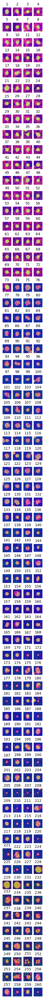

In [25]:
# Criar a pasta se não existir
output_folder = 'blur_images_13'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Fig = Figura, ax é o vetor de objetos Axes
# Número de linhas = 65 x Número de colunas = 4 imagens
fig, ax = plt.subplots(nrows=65, ncols=4, figsize=(2,50))

for x in range(1, 131):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_1.tif'
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_blur_13[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)
    # Salvar imagem HSV
    save_path = os.path.join(output_folder, f'img_{x:03d}.png')
    plt.imsave(save_path, img_list_blur_13[x-1])

for x in range(131, 261):
    img_path = 'ALL_IDB2/Im'+str(x).zfill(3)+'_0.tif'
    row = (x-1) // 4
    col = (x-1) % 4
    ax[row, col].imshow(img_list_blur_13[x-1])
    ax[row, col].axis('off')
    ax[row, col].set_title(x, fontsize=10)
    # Salvar imagem HSV
    save_path = os.path.join(output_folder, f'img_{x:03d}.png')
    plt.imsave(save_path, img_list_blur_13[x-1])

plt.savefig('imagens_carregadas_blur_13.png')
plt.show()

# Executando o K-Means após blur 13x13

In [26]:
dfs_h_13 = [] # Vetor de data frames

for i in range(1, 261):
  if h_score[1] == 'RGB':
    df = pd.DataFrame({'R': img_list_blur_13[i-1][:, :, 0].flatten(), 'G': img_list_blur_13[i-1][:, :, 1].flatten(), 'B':img_list_blur_13[i-1][:, :, 2].flatten()})
  else:
    df = pd.DataFrame({'H': img_list_blur_13[i-1][:, :, 0].flatten(), 'S': img_list_blur_13[i-1][:, :, 1].flatten(), 'V':img_list_blur_13[i-1][:, :, 2].flatten()})
  dfs_h_13.append(df)

In [27]:
h_segmented_list_13 = []
if h_score[1] == 'RGB':
    if h_score[2] == 2:
        segmented_list_k2_rgb, distances_k2_rgb = process_kmeans_rgb_2(dfs_h_13)
        h_segmented_list_13 = segmented_list_k2_rgb
    else:
        segmented_list_k3_rgb, distances_k3_rgb = process_kmeans_rgb_3(dfs_h_13)
        h_segmented_list_13 = segmented_list_k3_rgb
else:
    if h_score[2] == 2:
        segmented_list_k2_hsv, distances_k2_hsv = process_kmeans_hsv_2(dfs_h_13)
        h_segmented_list_13 = segmented_list_k2_hsv
    else:
        segmented_list_k3_hsv, distances_k3_hsv = process_kmeans_hsv_3(dfs_h_13)
        h_segmented_list_13 = segmented_list_k3_hsv

Im001_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.0546603798866272
Iteration: 2	Distance: 0.052240192890167236
Iteration: 3	Distance: 0.026904195547103882
Iteration: 4	Distance: 0.02196529507637024
Iteration: 5	Distance: 0.021403849124908447
Iteration: 6	Distance: 0.009505599737167358
Iteration: 7	Distance: 0.0018668174743652344
Iteration: 8	Distance: 0.00027811527252197266
k-Means has ended with 8 iteratinons
Im002_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.01799580454826355
Iteration: 2	Distance: 0.007157772779464722
Iteration: 3	Distance: 0.004056990146636963
Iteration: 4	Distance: 0.0025585591793060303
Iteration: 5	Distance: 0.0015610158443450928
Iteration: 6	Distance: 0.000997304916381836
k-Means has ended with 6 iteratinons
Im003_1.tif
---------- k=2	Euclidean distance HSV ----------
Iteration: 1	Distance: 0.02999746799468994
Iteration: 2	Distance: 0.012375235557556152
Iteration: 3	Distance: 0.00205081701278

# Imagens segmentadas pós blur 13x13

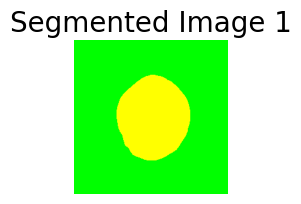

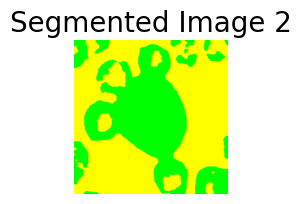

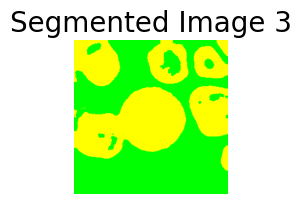

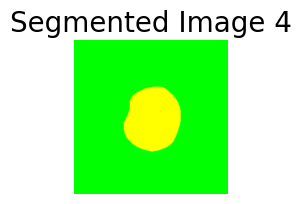

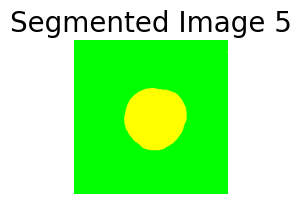

...

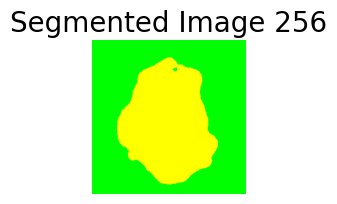

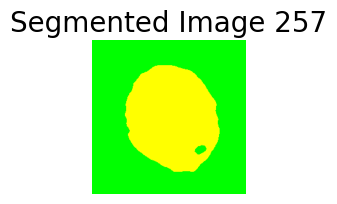

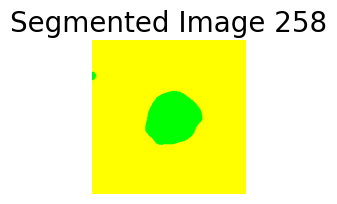

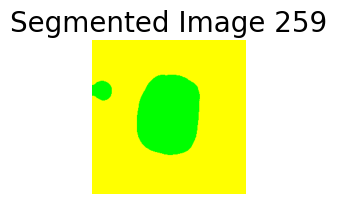

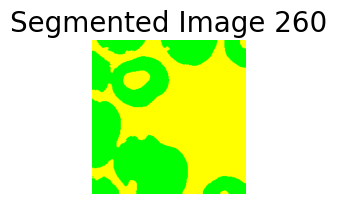

In [92]:
# Caminho para a pasta onde as imagens serão salvas
output_folder = 'segmented_images_high_score_13'

# Processa e salva as imagens segmentadas
process_and_save_segmented_images(h_segmented_list_13, output_folder, h_score[2])

# Score

In [28]:
def calculate_silhouette(i, df, k):
    segmented_df = df[i-1]
    if k == 2:
        score = silhouette_score(segmented_df.loc[:, :'C2'], segmented_df.Class, metric='euclidean')
    else:
        score = silhouette_score(segmented_df.loc[:, :'C3'], segmented_df.Class, metric='euclidean')
    print(f'Img {i}: {score}')
    return score

scores_blur13 = Parallel(n_jobs=4)(delayed(calculate_silhouette)(i, h_segmented_list_13, h_score[2]) for i in range(1, 261))
score_blur13_media = sum(scores_blur13)/len(scores_blur13) 
print(f'Média: {score_blur13_media}, Sistema de cores:{h_score[1]}, k = {h_score[2]}')

Img 1: 0.7631747126579285
Img 2: 0.5548136830329895
Img 3: 0.7321830987930298
Img 4: 0.7684914469718933
Img 5: 0.7621210217475891
Img 6: 0.7931459546089172
Img 7: 0.6998209357261658
Img 8: 0.7356529831886292
Img 9: 0.7320531010627747
Img 10: 0.6898519396781921
Img 11: 0.7006118297576904
Img 12: 0.5749217867851257
Img 13: 0.7046923637390137
Img 14: 0.7735982537269592
Img 15: 0.7654840350151062
Img 16: 0.7571800351142883
Img 17: 0.5259786248207092
Img 18: 0.7287799119949341
Img 19: 0.34655916690826416
Img 20: 0.7415394186973572
Img 21: 0.7195751667022705
Img 22: 0.7367336750030518
Img 23: 0.7700320482254028
Img 24: 0.7512267827987671
Img 25: 0.7209957242012024
Img 26: 0.7672864198684692
Img 27: 0.7139859199523926
Img 28: 0.7187283635139465
Img 29: 0.7550819516181946
Img 30: 0.7585012912750244
Img 31: 0.7446594834327698
Img 32: 0.5416907072067261
Img 33: 0.7503125667572021
Img 34: 0.711346447467804
Img 35: 0.7037106156349182
Img 36: 0.6804099082946777
Img 37: 0.5325303673744202
Img 38: 0.